In [28]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import os
import pandas as pd
from numpy.fft import ifftshift,fftshift,fft2,ifft2
from os.path import join, isfile
import pySPM
from math import pi
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from scipy.ndimage import gaussian_filter
from scipy.signal import find_peaks
import matplotlib.transforms as mtransforms

In [34]:

def Rotate_v(theta, v):
    theta = theta/180*pi
    rotation_matrix = np.zeros((2, 2)) 
    rotation_matrix[0, 0] = np.cos(theta) 
    rotation_matrix[1, 1] = np.cos(theta) 
    rotation_matrix[0, 1] = -np.sin(theta) 
    rotation_matrix[1, 0] = np.sin(theta) 
    return np.dot(rotation_matrix,v)

def plot_topo(SXMfile,fig,ax,title="SiC",scalecolor="white",scalesize=0.3): 
    Z_image=SXMfile.get_channel('Z')
    Z_image.correct_median_diff()
    Z_image.correct_lines() 
    x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9 
    img=Z_image.show(ax=ax,sig=None,cmap="Blues_r")
    ax.axis ('off')
    Vmin=np.ndarray.min(Z_image.pixels) 
    Vmax=np.ndarray.max(Z_image.pixels) 
    cb=fig.colorbar(img,ax=ax,orientation="vertical",pad=0.02,shrink=0.8) 
    cb.ax.yaxis.set_tick_params(size=0.8,labeltop=True) 
    cb.set_ticks([Vmax,Vmin])
    cb.set_ticklabels(["High","Low"])
    scale=int(x_n/10) 
    scalebar=AnchoredSizeBar(ax.transData,scale*2,"{0} nm".format(scale*2),"lower right",pad=1,sep=3,color=scalecolor,label_top=True,frameon=False,size_vertical=scalesize)
    ax.add_artist(scalebar)
    ax.set_title(title) 
    return img
def plot_profile(Z_image,ax,aximg,P1=[0,10],P2=[20,10]):
    P1_r=Rotate_v(0,P1)
    P2_r=Rotate_v(0,P2)
    profile=Z_image.plot_profile(P1_r[0],P1_r[1],P2_r[0],P2_r[1],ax=ax,img=aximg,ztransf=lambda x:x*1e9,zuit="nm",pixels=False,imgColor="w")
    profile_filtered = gaussian_filter(profile["z"], sigma=3)
    peak, _ = find_peaks(profile_filtered, distance=5)
    fig,(ax1,ax2)=plt.subplots(1,2,figsize=(14,5))
    ax1.grid()
    ax1.yaxis.set_minor_locator(mpl.ticker.AutoMinorLocator()) # set minor␣ticks every units 
    ax1.xaxis.set_minor_locator(mpl.ticker.AutoMinorLocator()) # set minor␣ticks automatically 
    ax1.grid(axis='both',which='minor',alpha=.1,color='r', linestyle='-',linewidth=2)
    peak_nm=profile["l"][peak]
    ax1.plot(peak_nm, profile_filtered[peak], "*",color="C3") 
    ax1.plot(profile["l"],profile_filtered)
    peak0=0
    peak_dis=[]
    for peaks in peak_nm:
        dis=peaks-peak0
        peak_dis.append(dis)
        peak0=peaks
    ax2.plot(peak_dis[1:],"*",color="C3")
    if len(peak_dis[1:])!=0:
       av=sum(peak_dis[1:])/len(peak_dis[1:])
       x=np.linspace(0,len(peak_dis[1:]),len(peak_dis[1:]))
       y=peak_dis[1:]
       a, b = np.polyfit(x, y, 1)
       ax2.scatter(x, y)
       ax2.plot(x, a*x+b)
       ax2.text(1,0,"y="+"{:.2f}".format(b)+"+{:.2f}".format(a)+"x",size=14)
       peak_dis=peak_dis[1:]
       av=sum(peak_dis)/len(peak_dis)
       sqrt=np.sqrt(peak_dis) 
       sqrtsum=sum(sqrt)/len(sqrt) 
       max_time=np.argmax(np.bincount(peak_dis))
       ax2.text(1,0.1,"Av="+"{:.2f}".format(av),size=14)  
       ax2.text(1,0.2,"Sqrt="+"{:.2f}".format(sqrtsum),size=14) 
       ax2.text(1,0.3,"times="+"{:.2f}".format(max_time),size=14)
def detect_lattice(Z_image,ax,P1,P2):
    x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9
    y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"] 
    P1_r=Rotate_v(0,P1)
    P2_r=Rotate_v(0,P2)
    x,profile=Z_image.get_profile(P1_r[0],P1_r[1],P2_r[0],P2_r[1])
    profile_filtered = gaussian_filter(profile, sigma=3)
    peak, _ = find_peaks(profile_filtered, distance=5)
    peak_nm=profile[peak]
    peak0=0
    peak_dis=[]
    for peaks in peak_nm:
        dis=peaks-peak0
        peak_dis.append(dis)
        peak0=peaks
    peak_dis=peak_dis[1:]
    if len(peak_dis)!=0:
       constant=sum(peak_dis)/len(peak_dis)
    else:
        constant=-1
    return constant

    

def plot_fft(SXMfile,fig,ax,space=50,title="FT image"): 
    Z_image=SXMfile.get_channel('Z')
    Z_image.correct_median_diff()
    Z_image.correct_lines() 
    x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9 
    d=x_n/space #Sample spacing 
    y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"] 
    y_freq=np.fft.fftshift(np.fft.fftfreq(y_p,d)) 
    x_freq=np.fft.fftshift(np.fft.fftfreq(x_p,d)) 
    extent=[x_freq[0],x_freq[-1],y_freq[0],y_freq[-1]]
    Z_fft = abs(np.fft.fftshift((np.fft.fft2(Z_image.pixels)))) 
    Z_fft=pySPM.zoom_center(Z_fft, sx=space, sy=space) 
    real={"x":-x_freq[0]+x_freq[-1],"y":y_freq[-1]-y_freq[0],"unit":"2pi/nm"} 
    Z_fft_image=pySPM.SPM_image(Z_fft,real=None)
    scalebar2=AnchoredSizeBar(ax.transData,1/0.438/1.731,r'$1/3a^{-1}$',"lower right",pad=1,sep=3,color="black",label_top=True,frameon=False,size_vertical=0.05)
    ax.add_artist(scalebar2)
    x=r'$q_x/2\pi$ $(nm^{-1})$'
    y=r'$q_y/2\pi$ $(nm^{-1})$'
    ax.set_xlabel(x)
    ax.set_ylabel(y)
    ax.set_title("The FFT image of kagome lattice") #ax2.set_extent(extent) 
    img=ax.imshow(Z_fft,origin="lower",extent=extent,cmap="gray_r")
    Vmin=np.ndarray.min(Z_fft_image.pixels) 
    Vmax=np.ndarray.max(Z_fft_image.pixels) 
    cb=fig.colorbar(img,ax=ax,orientation="vertical",pad=0.02,shrink=0.8) 
    cb.ax.yaxis.set_tick_params(size=0.8,labeltop=True) 
    cb.set_ticks([Vmax,Vmin])
    cb.set_ticklabels(["High","Low"])
    ax.set_title(title)

def get_file_path(dir,fileFolder,fileName):
    mydir=dir
    myFolder=fileFolder
    fileName=fileName
    return join(mydir,myFolder,fileName)

def plot_arrow(ax,pos,color="green",text=r"$Q_{\sqrt{3}*\sqrt{3}R30^0}$"): 
    ax.arrow(0,0,pos[0],pos[1],width=0.02,ec=color,head_length=0.1,length_includes_head=True) 
    circleArray=[]
    c1=(pos[0],pos[1]) 
    c1=Rotate_v(-0,c1) 
    for i in range(6):
         c=Rotate_v(60,c1)
         circleArray.append(c)
         c1=c
    for circleP in circleArray: 
        circle=plt.Circle(circleP,0.08,color=color,fill=False) 
        ax.add_patch(circle)
    pos = [pos[0]*1.1,pos[1]]
    ax.text(pos[0],pos[1],text,color=color)
def plot_image(filePath):
    SXMfile=pySPM.SXM(filePath)
    header=SXMfile.header
    Bias=header['BIAS'][0][0]
    Curr=header['Z-CONTROLLER'][1][3]
    Z_image=SXMfile.get_channel('Z')
    Z_image.correct_median_diff()
    Z_image.correct_lines()
    x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9
    y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"]  
    if x_n>20:
        pass
    else:
        fig,(ax0,ax1,ax2)=plt.subplots(1,3,figsize=(15,5))
        imgTopo=plot_topo(SXMfile=SXMfile,fig=fig,ax=ax0)
        ax0.text(2,2,Bias,color="black")
        plot_fft(SXMfile=SXMfile,fig=fig,ax=ax1,space=80)
        plot_profile(Z_image,ax2,ax0,P1=[0,x_n/2],P2=[x_n,x_n/2])
        constList=[]
        index=0.22/0.246
        lattice_g=0.246*index
        lattice_SiC=0.438
        rotation_A=60
        r_g=1/lattice_g
        r_SiC=1/lattice_SiC/3
        #pos=(r_g*np.sin(rotation_A*pi/180),r_g*np.cos(rotation_A*pi/180))
        #plot_arrow(ax1,pos,color="black",text=r"$Q_{Graphene}$")
        rotation_A=60
        pos=(r_SiC*np.sin(rotation_A*pi/180),r_SiC*np.cos(rotation_A*pi/180))
        plot_arrow(ax1,pos,color="blue",text=r"$Q_{3*3SiC}$")
        rotation_A=30
        fig.suptitle(filePath)

def plot_STS(filePath):
    df=pd.read_table(filePath,sep="\t",skiprows=17)
    fig,(ax0,ax1)=plt.subplots(2,1,figsize=(14,5))
    ax0.plot(df["Bias calc (V)"],df["Current (A)"])
    ax1.plot(df["Bias calc (V)"],df["LIY 1 omega (A)"])
    ax0.set_title(filePath)
def plot_spetrum(filePath,ax):
    df=pd.read_table(filePath,sep="\t",skiprows=17)
    sts_filtered=gaussian_filter(df["LIY 1 omega (A)"],sigma=2)
    ax.plot(df["Bias calc (V)"],sts_filtered)
    #ax.set_title(filePath)


Text(0.5, 1.0, '../../STMdata/20221116/Bias-Spectroscopy025.dat')

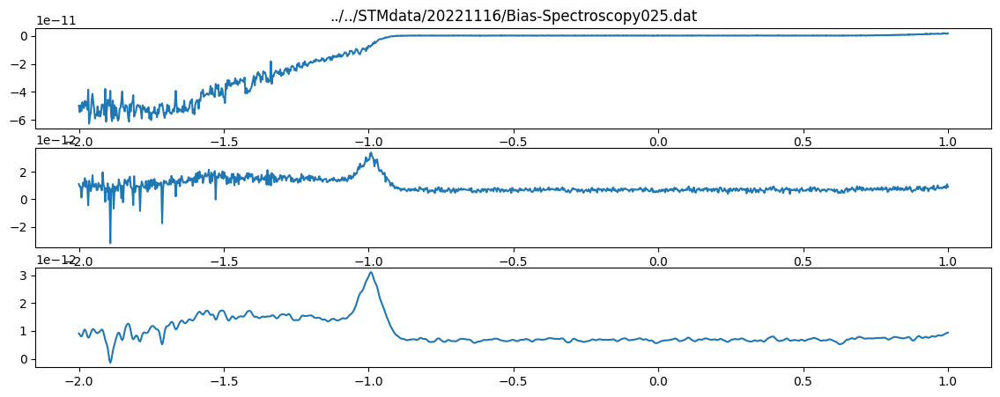

In [30]:
filePath="../../STMdata/20221116/Bias-Spectroscopy025.dat"
df=pd.read_table(filePath,sep="\t",skiprows=17)
fig,(ax0,ax1,ax2)=plt.subplots(3,1,figsize=(14,5))
ax0.plot(df["Bias calc (V)"],df["Current (A)"])
ax1.plot(df["Bias calc (V)"],df["LIY 1 omega (A)"])
sts_filtered=gaussian_filter(df["LIY 1 omega (A)"],sigma=2)
ax2.plot(df["Bias calc (V)"],sts_filtered)
ax0.set_title(filePath)
#plot_STS(filePath)
   

dict_items([('a', <Axes: label='a', title={'left': 'a', 'center': 'Normal Title'}>), ('c', <Axes: label='c'>), ('f', <Axes: label='f'>), ('h', <Axes: label='h'>), ('b', <Axes: label='b'>), ('d', <Axes: label='d'>), ('g', <Axes: label='g'>), ('i', <Axes: label='i'>), ('e', <Axes: label='e'>)])
dict_items([('a', <Axes: label='a', title={'left': 'a', 'center': 'Normal Title'}>), ('c', <Axes: label='c', title={'left': 'c', 'center': 'Normal Title'}>), ('f', <Axes: label='f'>), ('h', <Axes: label='h'>), ('b', <Axes: label='b'>), ('d', <Axes: label='d'>), ('g', <Axes: label='g'>), ('i', <Axes: label='i'>), ('e', <Axes: label='e'>)])
dict_items([('a', <Axes: label='a', title={'left': 'a', 'center': 'Normal Title'}>), ('c', <Axes: label='c', title={'left': 'c', 'center': 'Normal Title'}>), ('f', <Axes: label='f', title={'left': 'f', 'center': 'Normal Title'}>), ('h', <Axes: label='h'>), ('b', <Axes: label='b'>), ('d', <Axes: label='d'>), ('g', <Axes: label='g'>), ('i', <Axes: label='i'>), ('e'

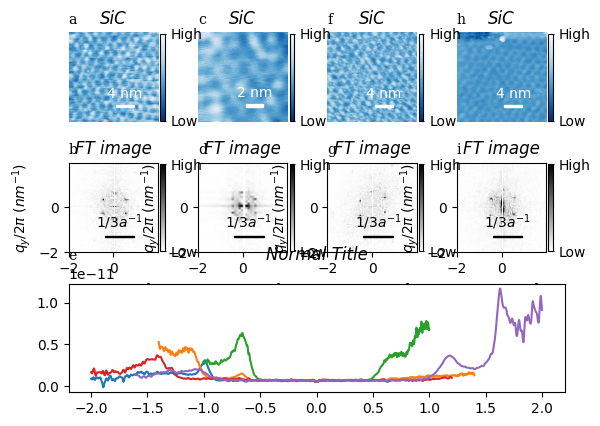

In [51]:
fig,axs=plt.subplot_mosaic([["a","c","f","h"],["b","d","g","i"],["e","e","e","e"]])
filePath="../../STMdata/20221116/SiC013.sxm"
SXMfile=pySPM.SXM(filePath)
header=SXMfile.header
Bias=header['BIAS'][0][0]
Curr=header['Z-CONTROLLER'][1][3]
Z_image=SXMfile.get_channel('Z')
Z_image.correct_median_diff()
Z_image.correct_lines()
x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9
y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"] 
for label,ax in axs.items():
    ax.set_title("Normal Title",fontstyle="italic")
    ax.set_title(label,fontfamily="serif",loc="left",fontsize="medium")
    print(axs.items())
plot_topo(SXMfile,fig,axs["a"],title="SiC",scalecolor="white",scalesize=0.3)
plot_fft(SXMfile,fig,axs["b"],space=80,title="FT image")
filePath="../../STMdata/20221116/Bias-Spectroscopy025.dat"
plot_spetrum(filePath,axs["e"])
filePath="../../STMdata/20221116/Bias-Spectroscopy066.dat"
plot_spetrum(filePath,axs["e"])
filePath="../../STMdata/20221116/Bias-Spectroscopy068.dat"
plot_spetrum(filePath,axs["e"])
filePath="../../STMdata/20221116/Bias-Spectroscopy131.dat"
plot_spetrum(filePath,axs["e"])
filePath="../../STMdata/20221116/Bias-Spectroscopy137.dat"
plot_spetrum(filePath,axs["e"])
filePath="../../STMdata/20221116/SiC030.sxm"
SXMfile=pySPM.SXM(filePath)
header=SXMfile.header
Bias=header['BIAS'][0][0]
Curr=header['Z-CONTROLLER'][1][3]
Z_image=SXMfile.get_channel('Z')
Z_image.correct_median_diff()
Z_image.correct_lines()
x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9
y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"] 
plot_topo(SXMfile,fig,axs["c"],title="SiC",scalecolor="white",scalesize=0.3)
plot_fft(SXMfile,fig,axs["d"],space=40,title="FT image")

filePath="../../STMdata/20221116/SiC124.sxm"
SXMfile=pySPM.SXM(filePath)
header=SXMfile.header
Bias=header['BIAS'][0][0]
Curr=header['Z-CONTROLLER'][1][3]
Z_image=SXMfile.get_channel('Z')
Z_image.correct_median_diff()
Z_image.correct_lines()
x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9
y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"] 
plot_topo(SXMfile,fig,axs["f"],title="SiC",scalecolor="white",scalesize=0.3)
plot_fft(SXMfile,fig,axs["g"],space=80,title="FT image")


filePath="../../STMdata/20221116/SiC104.sxm"
SXMfile=pySPM.SXM(filePath)
header=SXMfile.header
Bias=header['BIAS'][0][0]
Curr=header['Z-CONTROLLER'][1][3]
Z_image=SXMfile.get_channel('Z')
Z_image.correct_median_diff()
Z_image.correct_lines()
x_n,y_n=Z_image.size["real"]["x"]*1e9,Z_image.size["real"]["y"]*1e9
y_p,x_p=Z_image.size["pixels"]["y"],Z_image.size["pixels"]["x"] 
plot_topo(SXMfile,fig,axs["h"],title="SiC",scalecolor="white",scalesize=0.3)
plot_fft(SXMfile,fig,axs["i"],space=80,title="FT image")
plt.show()

['../../STMdata/20221116/Bias-Spectroscopy001.dat', '../../STMdata/20221116/Ag(111)001.sxm', '../../STMdata/20221116/Ag(111)002.sxm', '../../STMdata/20221116/Bias-Spectroscopy002.dat', '../../STMdata/20221116/Bias-Spectroscopy003.dat', '../../STMdata/20221116/Bias-Spectroscopy004.dat', '../../STMdata/20221116/Bias-Spectroscopy005.dat', '../../STMdata/20221116/Bias-Spectroscopy006.dat', '../../STMdata/20221116/SiC001.sxm', '../../STMdata/20221116/Bias-Spectroscopy007.dat', '../../STMdata/20221116/Bias-Spectroscopy008.dat', '../../STMdata/20221116/Bias-Spectroscopy009.dat', '../../STMdata/20221116/Bias-Spectroscopy010.dat', '../../STMdata/20221116/Bias-Spectroscopy011.dat', '../../STMdata/20221116/Bias-Spectroscopy012.dat', '../../STMdata/20221116/Bias-Spectroscopy013.dat', '../../STMdata/20221116/Bias-Spectroscopy014.dat', '../../STMdata/20221116/Bias-Spectroscopy015.dat', '../../STMdata/20221116/Bias-Spectroscopy016.dat', '../../STMdata/20221116/Bias-Spectroscopy017.dat', '../../STMdat

/var/folders/8d/w_xpr3211zd4h4xtl585mj8w0000gn/T/ipykernel_1350/3567547767.py:174: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,(ax0,ax1)=plt.subplots(2,1,figsize=(14,5))


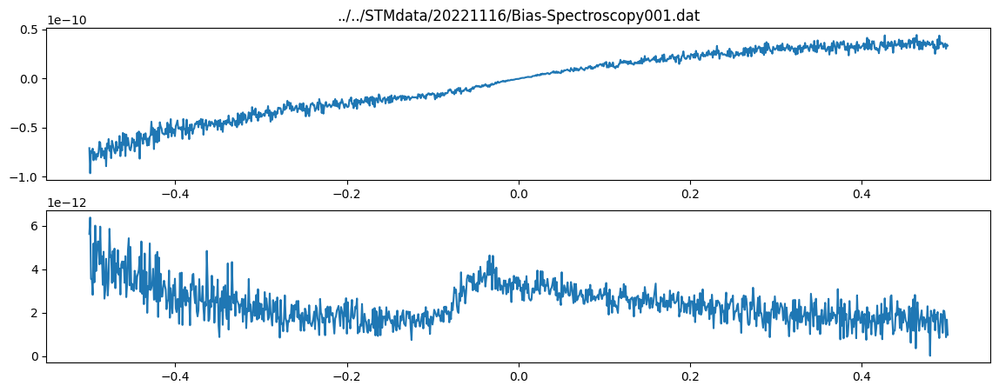

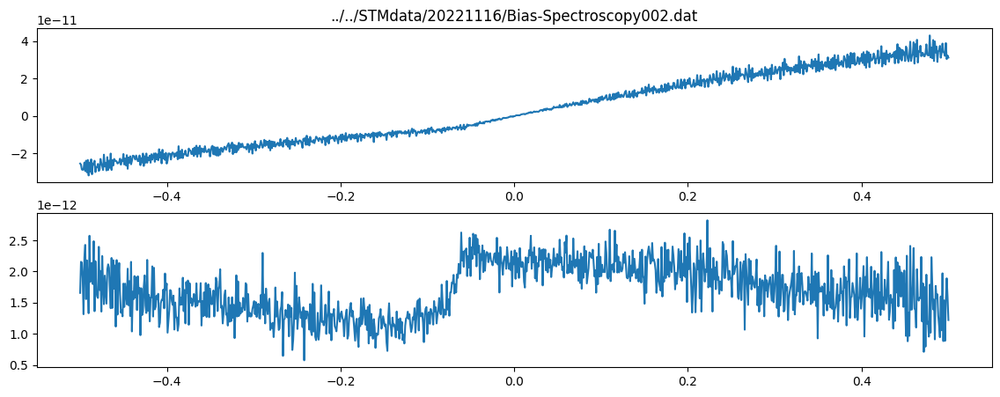

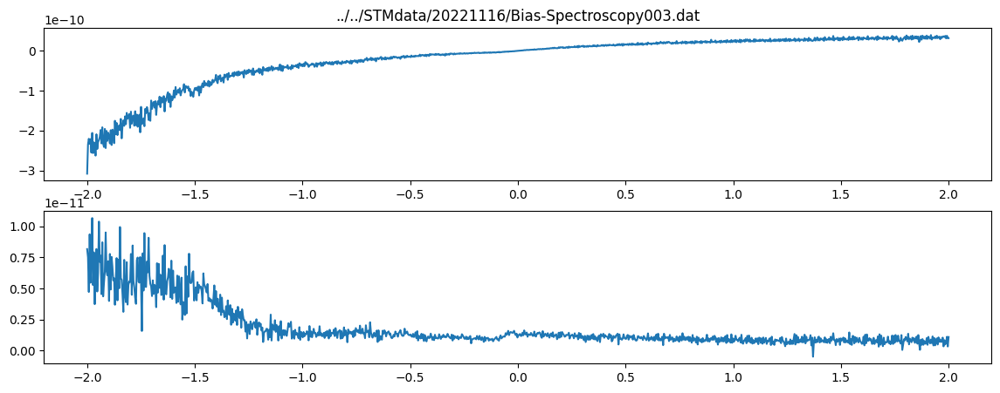

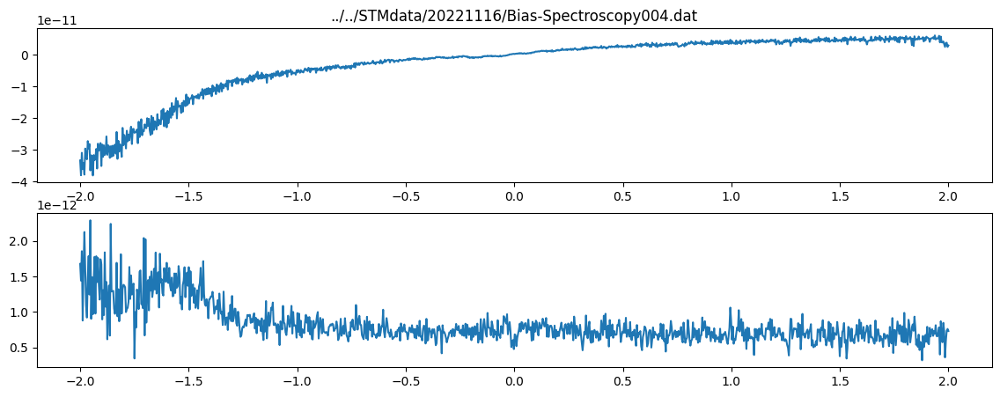

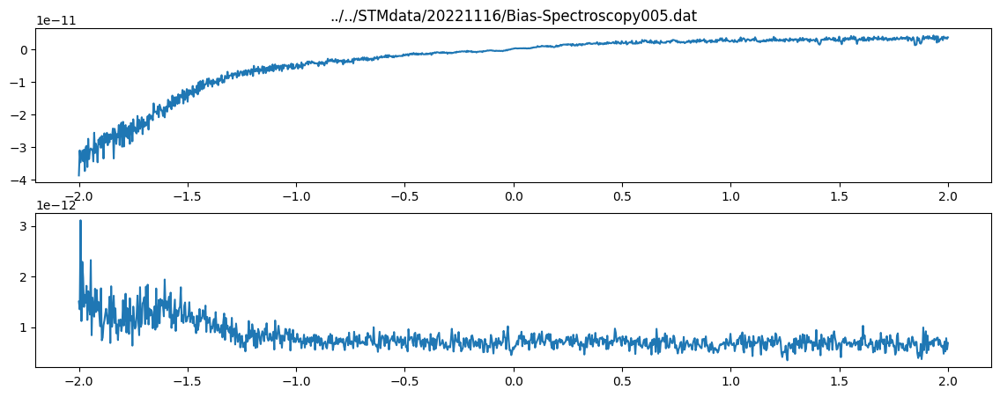

...

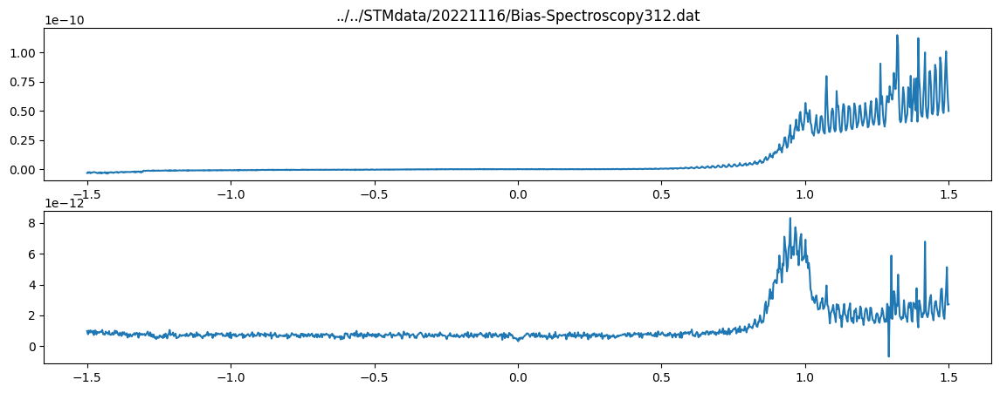

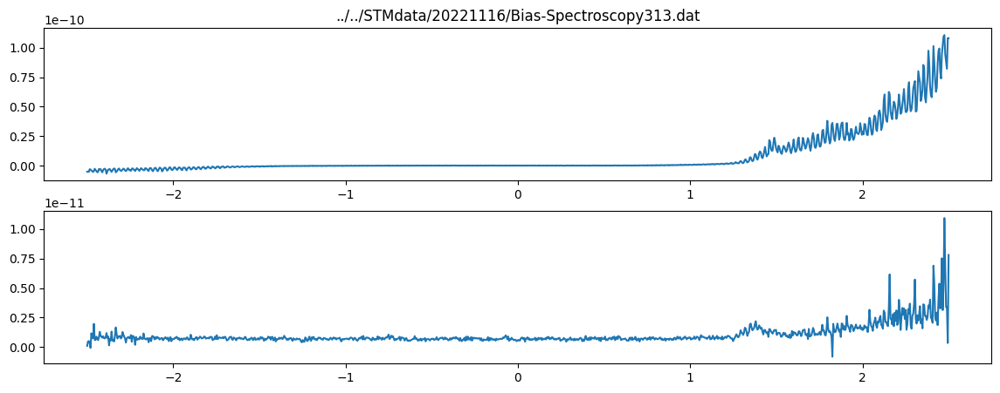

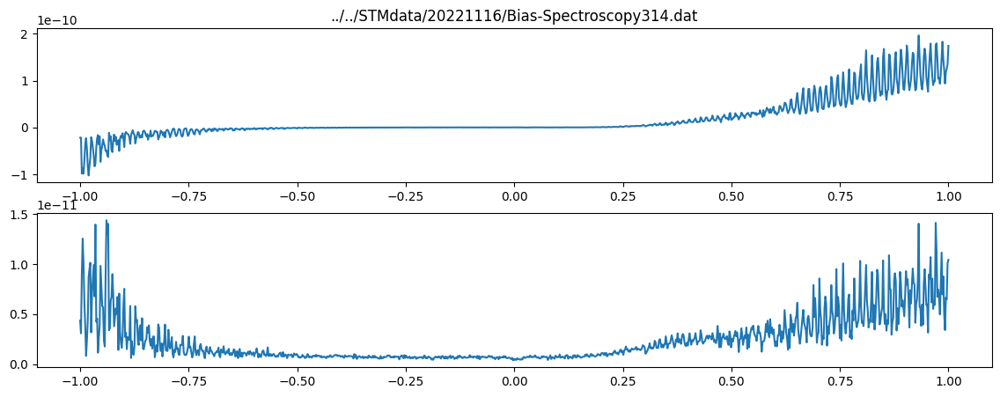

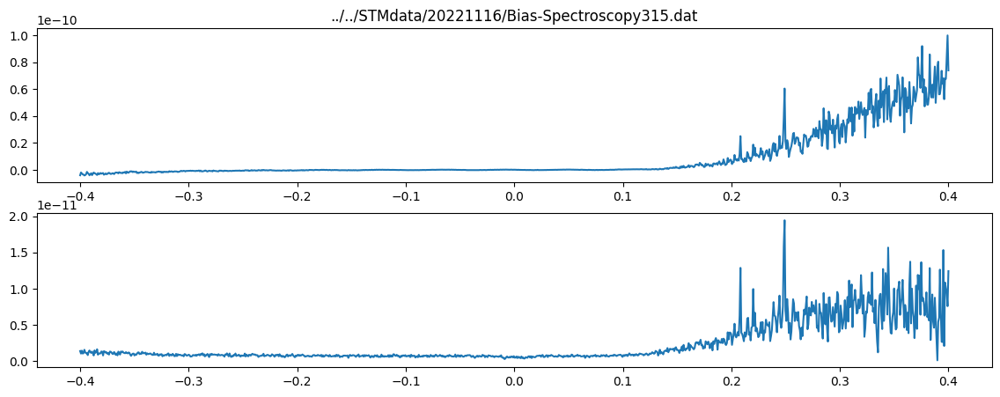

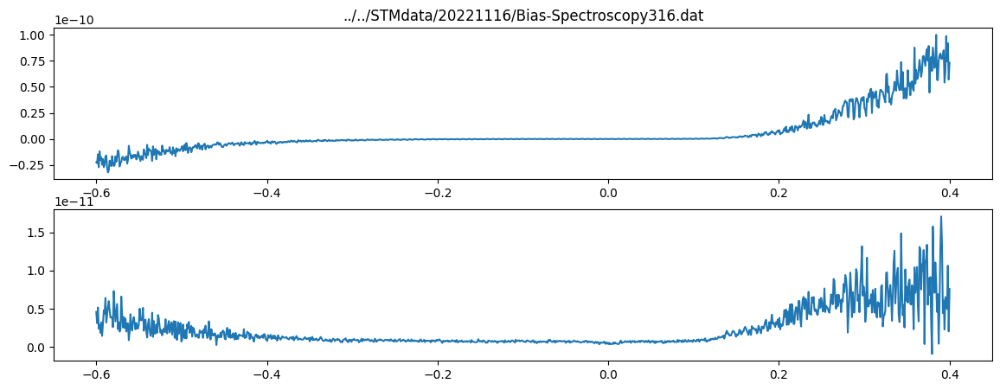

In [19]:
mydir,myFolder,fileName="../../STMdata","20221116","SiC001.sxm"
mypath=join(mydir,myFolder)
files=[f for f in os.listdir(mypath) if isfile(join(mypath,f))]
filePaths=[join(mypath,file) for file in files]
filePaths.sort(key=os.path.getmtime)
print(filePaths)
for filePath in filePaths: 
    if filePath.endswith(".sxm"):
        #plot_image(filePath)
        pass
    elif filePath.endswith(".dat"):
        plot_STS(filePath)

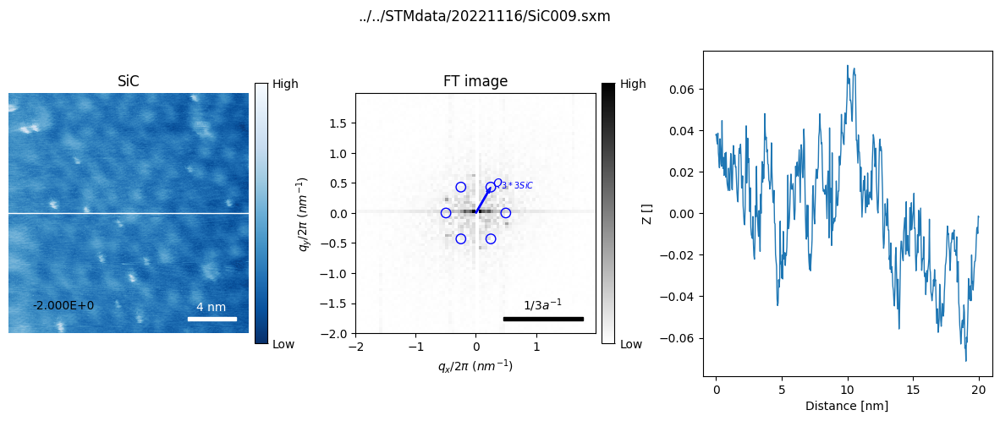

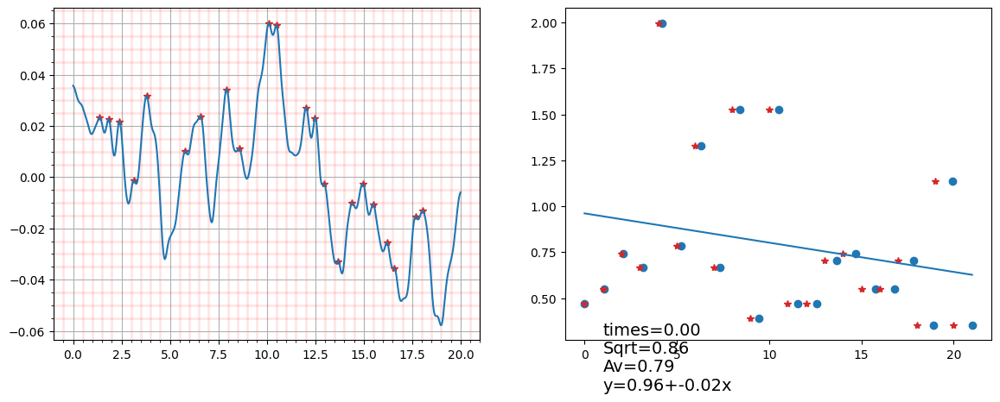

In [43]:
filePath="../../STMdata/20221116/SiC009.sxm"
plot_image(filePath)

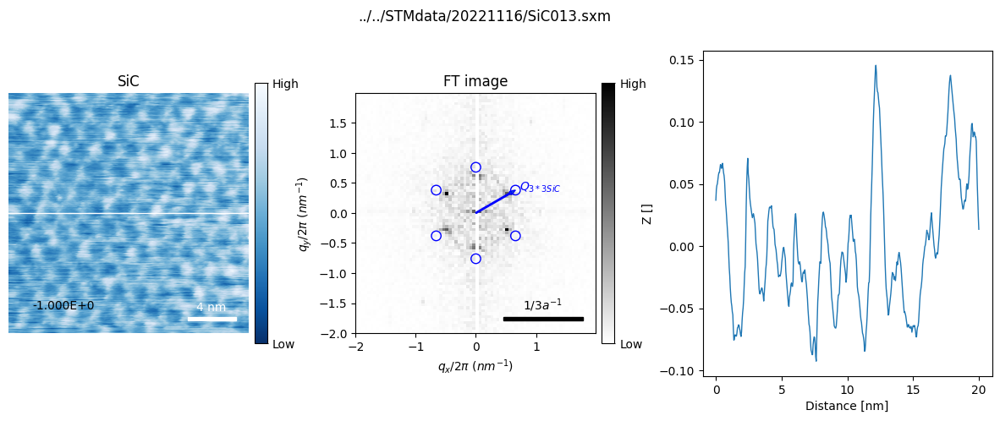

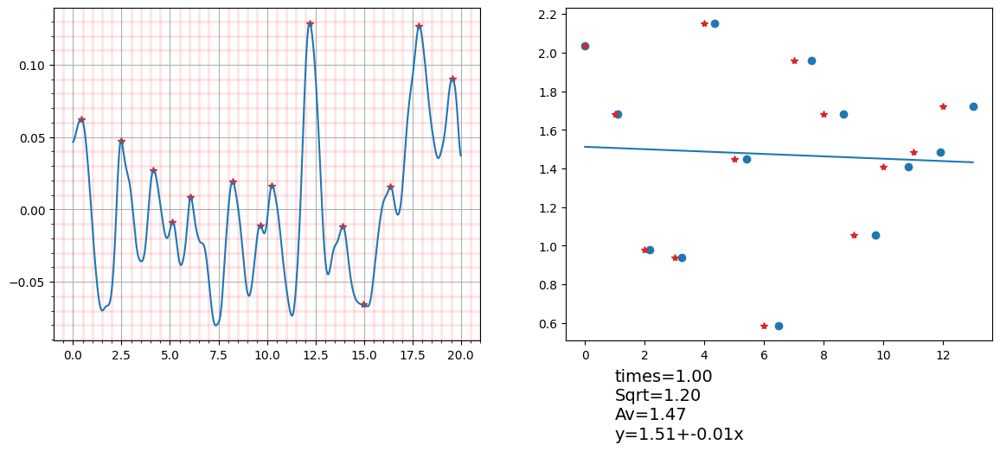

In [51]:
filePath="../../STMdata/20221116/SiC013.sxm"
plot_image(filePath)

In [ ]:
filePath="../../STMdata/20221116/SiC176.sxm"
SXMfile=pySPM.SXM(filePath)
print(SXMfile.header)
header=SXMfile.header
Bias=header['BIAS'][0][0]
Curr=header['Z-CONTROLLER'][1][3]
print(Bias,Curr)
Z_image=SXMfile.get_channel('Z')
Z_image.correct_median_diff()
Z_image.correct_lines()




In [ ]:
mydir,myFolder,fileName="../../STMdata","20221116","SiC001.sxm"
mypath=join(mydir,myFolder)
files=[f for f in os.listdir(mypath) if isfile(join(mypath,f))]
filePaths=[join(mypath,file) for file in files]
filePaths.sort(key=os.path.getmtime)
print(filePaths)
for filePath in filePaths: 
    if filePath.endswith(".sxm"):
        plot_image(filePath)
        pass
    elif filePath.endswith(".dat"):
        plot_STS(filePath)

In [ ]:
mydir,myFolder,fileName="../../STMdata","20221207","SiC001.sxm"
mypath=join(mydir,myFolder)
files=[f for f in os.listdir(mypath) if isfile(join(mypath,f))]
filePaths=[join(mypath,file) for file in files]
filePaths.sort(key=os.path.getmtime)
print(filePaths)
for filePath in filePaths: 
    if filePath.endswith(".sxm"):
        plot_image(filePath)
        pass
    elif filePath.endswith(".dat"):
        plot_STS(filePath)

In [ ]:
mydir,myFolder,fileName="../../STMdata","20230201","SiC006.sxm"
mypath=join(mydir,myFolder)
files=[f for f in os.listdir(mypath) if isfile(join(mypath,f))]
filePaths=[join(mypath,file) for file in files]
filePaths.sort(key=os.path.getmtime)
print(filePaths)
for filePath in filePaths: 
    if filePath.endswith(".sxm"):
        plot_image(filePath)
        pass
    elif filePath.endswith(".dat"):
        plot_STS(filePath)


